# 영상필터처리

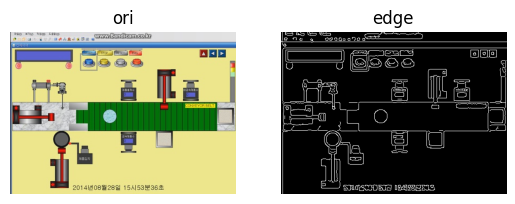

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('./public/ml_sample.jpg')

img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
blurred = cv2.GaussianBlur(img, (7,7), 0)
edge = cv2.Canny(blurred, 50 , 150)

plt.subplot(1,2,1)
plt.imshow(img_rgb, cmap="gray")
plt.title("ori")
plt.axis("off")

plt.subplot(1,2,2)
plt.imshow(edge, cmap="gray")
plt.title("edge")
plt.axis("off")

plt.show()



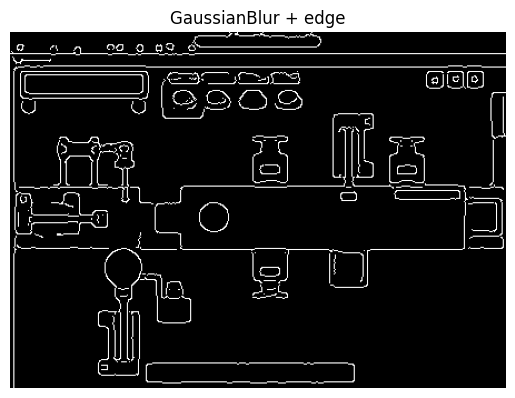

NG(공정 B의 의심)프레임: [ 900  901  902  903  904  905  906  908  909  917  918  919  922  923
  924  925  926  927  970  971  972  973  974  975  976  977  978  980
  981  982  983  984  985  988  989  990  991  992  993  994  998  999
 1000 1001 1002 1003 1004 1005 1006 1007 1008 1009 1010 1015 1016 1017
 1019 1020 1021 1022 1023 1024 1025 1026 1027 1028 1029 1030 1031 1032
 1033 1034 1035 1036 1037 1038 1039 1040 1041 1042 1043 1044 1045 1046
 1047 1048 1050 1051 1052 1053 1054 1055 1056 1057 1058 1059 1060 1061
 1062 1063 1064 1065 1066 1107 1108 1109 1110 1111 1112 1113 1114 1115
 1116 1117 1118 1119 1211 1216 1217 1220 1244 1245 1246 1247 1248 1249
 1250 1251 1252 1253 1254 1255 1256 1257 1258 1259 1260 1261 1262 1263
 1264 1265 1266 1267 1268 1269 1270 1271 1272 1273 1274 1275 1276 1277
 1278 1279 1280 1281 1282 1283 1284 1285 1286 1287 1288 1289 1290 1291
 1292 1293 1294 1295 1296 1297 1298 1299 1300 1301 1302 1303 1304 1305
 1306 1307 1308 1309 1310 1311 1312 1313 1314 1315 1316 1317

In [ ]:
import cv2
import numpy as np
from sklearn.svm import OneClassSVM

video_path = "D:\\kys\\public\\old_scada.mp4"
cap = cv2.VideoCapture(video_path)


def mask_time(frame):
    frame[54:94,433:445] = 0 # 검은색,  cv2에서는 y 와 x 가 거꾸로 
    frame[298:315,122:310] = 0 # 검은색, cv2에서는 y 와 x 가 거꾸로 
    return frame

def extract_feature(frame):
    frame = mask_time(frame)
    blurred = cv2.GaussianBlur(frame, (11,11), 0)
    edge = cv2.Canny(blurred, 50, 130)
    resized = cv2.resize(edge,(32, 32)) # 크기축소 (전체구조를 요약) 320 X 446 -> 32 X 32 로 바꿔서 속도향상, 메모리 절감
    feature = resized.flatten() / 255.0 # 정규화 백터화
    return feature, edge

train_feature = []
test_feature = []
frame_idx = 0
while True:
    ret, frame = cap.read()
    if not ret: break

    feature, edge = extract_feature(frame)
    if frame_idx == 313:
        plt.imshow(edge, cmap="gray")
        plt.title("GaussianBlur + edge")
        plt.axis("off")
        plt.show()
    if frame_idx <= 828:
        train_feature.append(feature)
    elif 828 < frame_idx < 1337:
        test_feature.append(feature)     
    frame_idx += 1 
cap.release()
X_train = np.array(train_feature)
X_test = np.array(test_feature)
# One - Class SVM 학습
ocsvm = OneClassSVM(kernel="rbf", gamma="auto", nu=0.05)
# 훈련
ocsvm.fit(X_train) 
# 이상 탐지
pred = ocsvm.predict(X_test) # 1:정상 , -1: 비정상
abnormal_idx = np.where(pred==-1)[0] + 828
print("NG(공정 B의 의심)프레임:", abnormal_idx, len(abnormal_idx) )


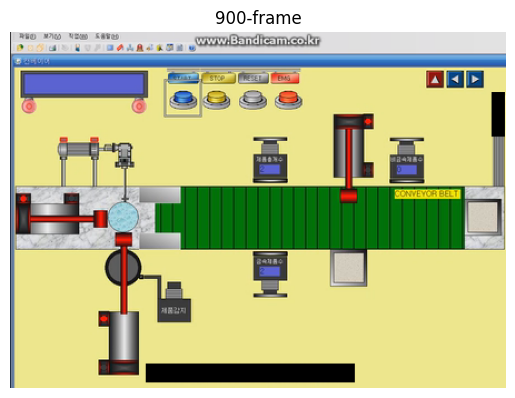

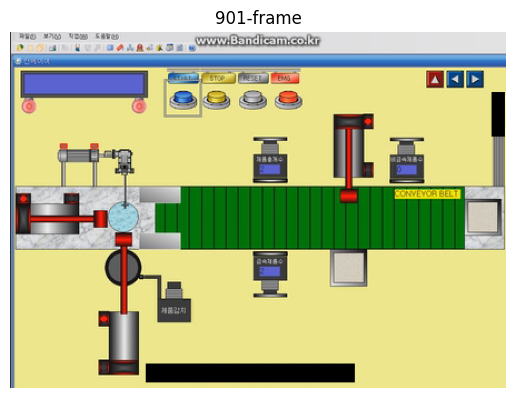

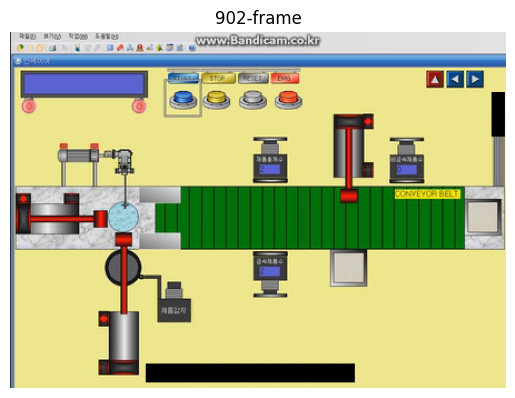

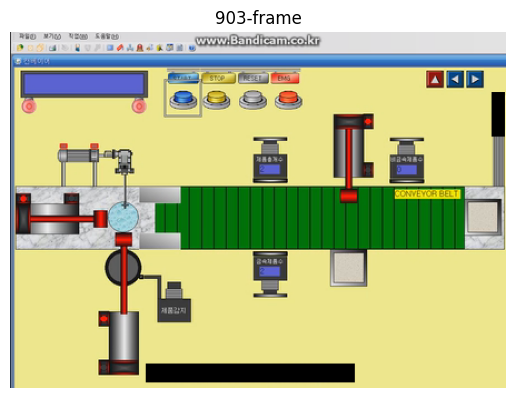

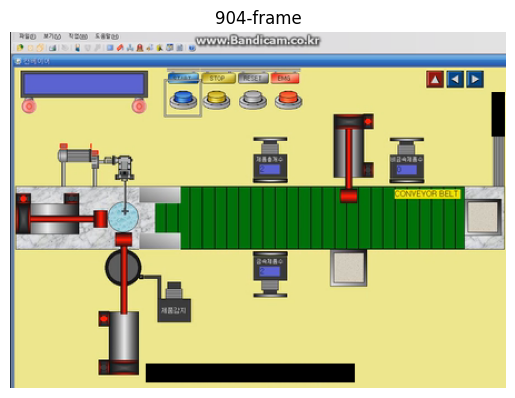

...

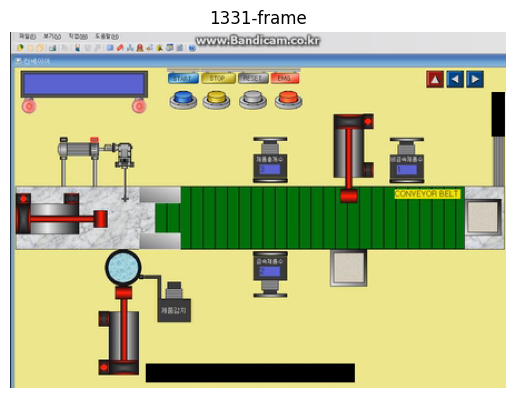

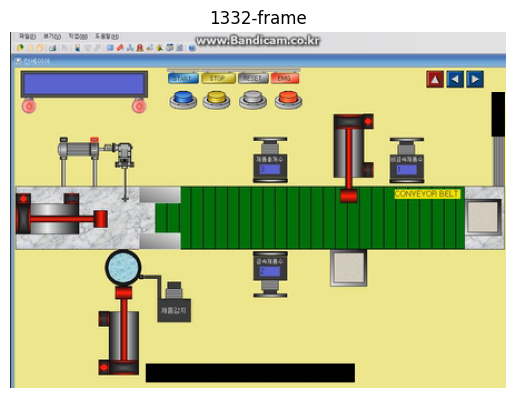

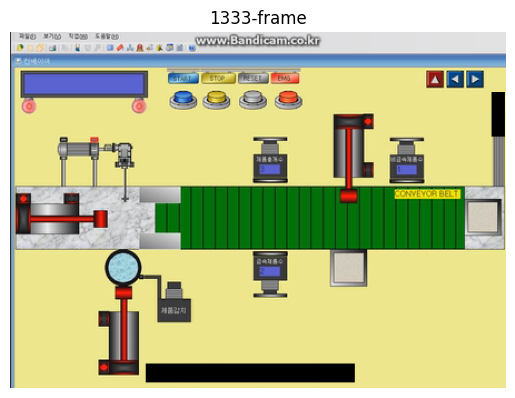

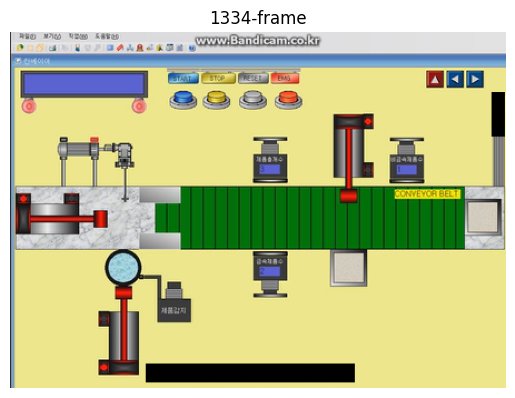

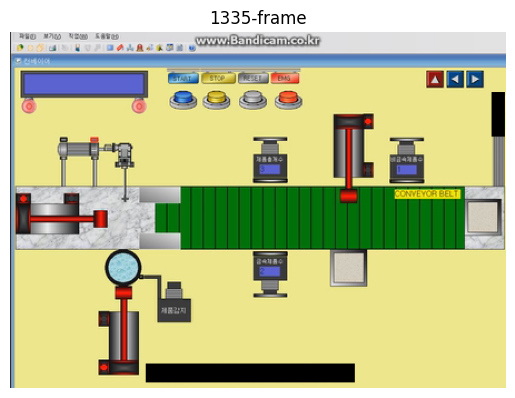

In [18]:
# 특정 프레임 보기
import matplotlib.pyplot as plt
cap = cv2.VideoCapture(video_path)
for position in abnormal_idx:
    cap.set(cv2.CAP_PROP_POS_FRAMES, position)
    _ , frame = cap.read()
    frame = mask_time(frame)
    rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb)
    plt.title(f"{position}-frame")
    plt.axis("off")
    plt.show()
cap.release()